In [225]:
import anndata
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import requests
import scanpy as sc
import sklearn.decomposition #import TruncatedSVD
import scipy 
import sparse, io
import os 
matplotlib.rcParams.update({'font.size': 12})
%config InlineBackend.figure_format = 'retina'

In [226]:
adata_pl_1=anndata.read_h5ad('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/adata_pl_sing_batch_processed.h5ad')


In [227]:
#Second spleen dataset
from cellbender.remove_background.downstream import anndata_from_h5
adata_pl_2_raw= sc.read_10x_h5('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/matrix_filtered_clear/second_spleen/output_filtered.h5')
adata_pl_2_raw=anndata_from_h5('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/matrix_filtered_clear/second_spleen/output_filtered.h5')

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


Assuming we are loading a "filtered" file that contains only cells.


In [156]:
adata_pl_2_raw

AnnData object with n_obs × n_vars = 11662 × 65597
    obs: 'background_fraction', 'cell_probability', 'cell_size', 'droplet_efficiency'
    var: 'ambient_expression', 'feature_type', 'genome', 'gene_id', 'cellbender_analyzed'
    uns: 'barcode_indices_for_latents', 'cell_size_lognormal_std', 'empty_droplet_size_lognormal_loc', 'empty_droplet_size_lognormal_scale', 'swapping_fraction_dist_params', 'barcodes_analyzed', 'barcodes_analyzed_inds', 'estimator', 'features_analyzed_inds', 'fraction_data_used_for_testing', 'learning_curve_learning_rate_epoch', 'learning_curve_learning_rate_value', 'learning_curve_test_elbo', 'learning_curve_test_epoch', 'learning_curve_train_elbo', 'learning_curve_train_epoch', 'target_false_positive_rate'
    obsm: 'gene_expression_encoding'

In [185]:
souporcell=pd.read_table('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nick/Pleuro/outs/20230704_spleen_R2_soup/20230603_24h_soup_res/clusters.tsv')
souporcell

,barcode,status,assignment,singlet_posterior,doublet_posterior,log_prob_singleton,log_prob_doublet,cluster0,cluster1,cluster2
0,AAACCCAAGCACTCTA-1,singlet,1,1.0,0.000000e+00,-476.895066,-526.916600,-2266.284425,-476.895066,-843.714799
1,AAACCCACAATAGAGT-1,singlet,2,1.0,6.500000e-15,-233.676040,-266.341333,-929.772771,-343.562655,-233.676040
2,AAACCCACAATAGTCC-1,singlet,1,1.0,0.000000e+00,-333.153922,-373.333040,-1667.069081,-333.153922,-579.373432
3,AAACCCACACGTTGGC-1,singlet,2,1.0,0.000000e+00,-813.298115,-1033.095585,-3586.345539,-1456.674688,-813.298115
4,AAACCCACAGTGACCC-1,singlet,0,1.0,0.000000e+00,-22.593581,-114.307732,-22.593581,-285.190253,-239.853815
...,...,...,...,...,...,...,...,...,...,...
9980,TTTGTTGGTATTGAGA-1,singlet,1,1.0,6.791000e-12,-220.395286,-246.110699,-1149.975139,-220.395286,-372.034923
9981,TTTGTTGGTCTAATCG-1,singlet,2,1.0,1.414710e-03,-302.604489,-309.163904,-1157.576214,-350.668457,-302.604489
9982,TTTGTTGGTGGAGGTT-1,singlet,2,1.0,1.724093e-05,-38.595199,-49.563407,-218.997479,-69.035899,-38.595199
9983,TTTGTTGGTTCGTGCG-1,singlet,1,1.0,0.000000e+00,-383.322896,-440.805519,-2106.151926,-383.322896,-750.134991


In [228]:
#Load in the anndata from soupor cell
souporcell=pd.read_table('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nick/Pleuro/outs/20230704_spleen_R2_soup/20230603_24h_soup_res/clusters.tsv')
adata_pl_2_raw.obs['Animal']='NA'
adata_pl_2_raw.obs['Status']='NA'
animal_mapper= dict(zip(souporcell['barcode'], souporcell['assignment']))
doublet_mapper= dict(zip(souporcell['barcode'], souporcell['status']))

for i in adata_pl_2_raw.obs.index:
    if i in animal_mapper:
        adata_pl_2_raw.obs.loc[i,'Animal']=animal_mapper[i]
    if i in doublet_mapper:
        adata_pl_2_raw.obs.loc[i,'Status']=doublet_mapper[i]

In [158]:
adata_pl_2_raw.obs['Animal'].value_counts()
#adata_pl_2_raw.obs['Status'].value_counts()

Animal
2      3633
1      3539
NA     2574
0       568
1/2     433
1/0     407
2/0     274
2/1     183
0/2      45
0/1       6
Name: count, dtype: int64

In [229]:
#Filtering the raw spleen dataset
sc.pp.filter_cells(adata_pl_2_raw, min_genes=200)
sc.pp.filter_genes(adata_pl_2_raw, min_cells=3)
mt_gene_patterns = ['COX1', 'COX2', 'ATP8', 'ATP6', 'COX3', 'NU1M', 'NU2M', 'NU3M', 'NU4M', 'NU4LM', 'NU5M', 'NU6M', 'CYB']
mt_gene_pattern = '|'.join(mt_gene_patterns)
adata_pl_2_raw.var['mt'] = adata_pl_2_raw.var_names.str.match(mt_gene_pattern)
sc.pp.calculate_qc_metrics(adata_pl_2_raw, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
adata_pl_2_raw = adata_pl_2_raw[adata_pl_2_raw.obs.pct_counts_mt < 10, :]
adata_pl_2_raw = adata_pl_2_raw[adata_pl_2_raw.obs.n_genes_by_counts < 2500, :]

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/nikvaku/.local/lib/python3.9/site-packages/a

In [131]:
adata_pl_2_raw=adata_pl_2_raw.copy()

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [128]:
adata_pl_1

AnnData object with n_obs × n_vars = 6929 × 31993
    obs: 'background_fraction', 'cell_probability', 'cell_size', 'droplet_efficiency', 'soup_assign', 'Animal', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'mt_score', 'hematopoetic_score', 'B_cells_score', 'prob_cells_score', 'macrophages_score', 'erythrocyte_progen_score', 'plasma_cells_score', 'neutrophil_score', 'cd4_tcell_score', 'cd8_tcell_score'
    var: 'ambient_expression', 'feature_type', 'genome', 'gene_id', 'cellbender_analyzed', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'Animal_colors', 'cell_size_lognormal_std', 'empty_droplet_size_lognormal_loc', 'empty_droplet_size_lognormal_scale', 'estimator', 'features_analyzed_inds', 'fraction_data_used_for_testing', 'learning_curve_learning_rate_epoch', 'learning_curve_learning_rate_value', 'learning_curve_test_elbo', 'learning_curve_test_epoch', 'learning_cur

In [138]:
#Run SCVI for the doublets
import scvi
scvi.model.SCVI.setup_anndata(adata_pl_2_raw)
vae = scvi.model.SCVI(adata_pl_2_raw)
vae.train()
solo = scvi.external.SOLO.from_scvi_model(vae)
solo.train()
df = solo.predict()

/home/nikvaku/PycharmProjects/samap/lib/python3.9/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/nikvaku/PycharmProjects/samap/lib/python3.9/si ...
  rank_zero_warn(
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/nikvaku/PycharmProjects/samap/lib/python3.9/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/nikvaku/PycharmProjects/samap/lib/python3.9/si ...
  rank_zero_warn(


Epoch 400/400: 100%|██████████| 400/400 [35:55<00:00,  4.92s/it, v_num=1, train_loss_step=3.48e+3, train_loss_epoch=3.39e+3]

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|██████████| 400/400 [35:55<00:00,  5.39s/it, v_num=1, train_loss_step=3.48e+3, train_loss_epoch=3.39e+3]
INFO     Creating doublets, preparing SOLO model.                                                                  


/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/merge.py:217: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(dtype):
/home/nikvaku/PycharmProjects/samap/lib/python3.9/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/nikvaku/PycharmProjects/samap/lib/python3.9/si ...
  rank_zero_warn(
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/nikvaku/PycharmProjects/samap/lib/python3.9/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used

Epoch 400/400: 100%|██████████| 400/400 [02:37<00:00,  2.58it/s, v_num=1, train_loss_step=0.446, train_loss_epoch=0.331]

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|██████████| 400/400 [02:37<00:00,  2.55it/s, v_num=1, train_loss_step=0.446, train_loss_epoch=0.331]


In [139]:
df['prediction'] = solo.predict(soft=False)

In [140]:
df['prediction'].value_counts()

prediction
singlet    5087
doublet    2564
Name: count, dtype: int64

In [183]:
#Save the df
df.to_csv('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Inter_data/second_spleen_doublet_scvi.csv')

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


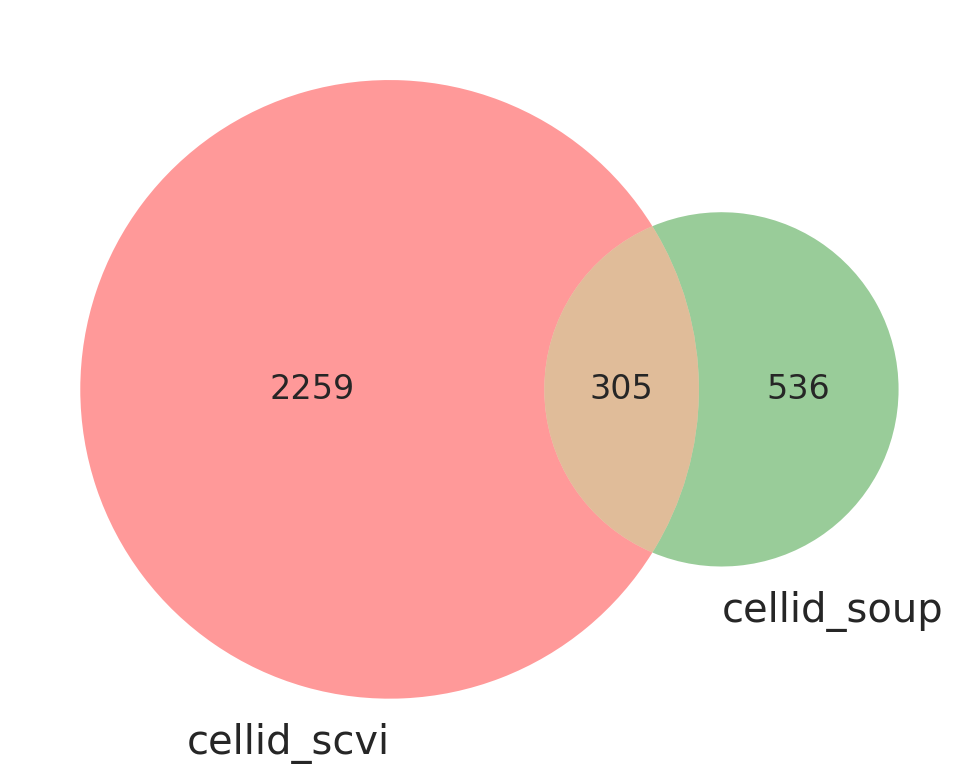

In [230]:
#Remove doublets
#ADD both the doublet objects to create a new one
adata_pl_2_raw_dob = adata_pl_2_raw[(adata_pl_2_raw.obs['Status'] == 'doublet') ]
cellid_soup=adata_pl_2_raw_dob.obs.index
cellid_scvi=df[df['prediction']=='doublet'].index
common_elements = set(cellid_scvi).intersection(cellid_soup)
cellid_scvi = set(cellid_scvi)
cellid_soup = set(cellid_soup)
from matplotlib_venn import venn2
import matplotlib.pyplot as plt
venn2([cellid_scvi, cellid_soup], ('cellid_scvi', 'cellid_soup'))
doublets= cellid_scvi.union(cellid_soup)
doublets=list(doublets)

In [231]:
doublets_in_adata_pl_2_raw = list(set(doublets).intersection(adata_pl_2_raw.obs_names))
adata_pl_2_raw.obs.loc[doublets_in_adata_pl_2_raw, 'Status'] = 'doublet'

In [232]:
adata_pl_2_raw.obs['Status'].value_counts()

Status
doublet       3100
singlet       2917
NA            1435
unassigned     199
Name: count, dtype: int64

In [233]:
#Discard cells with NA status and '0' animal
adata_pl_2_raw = adata_pl_2_raw[adata_pl_2_raw.obs['Status'] != 'NA']
adata_pl_2_raw = adata_pl_2_raw[adata_pl_2_raw.obs['Animal'] != '0']

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [234]:
adata_pl_2_raw = adata_pl_2_raw[adata_pl_2_raw.obs['Status'] == 'singlet']

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [237]:
adata_pl_2_raw.obs['Animal'].value_counts()

Animal
4    2793
3    1522
Name: count, dtype: int64

In [236]:
#Rename Animal '1' to '3' and '2' to '4'
adata_pl_2_raw.obs['Animal'] = adata_pl_2_raw.obs['Animal'].replace({'1': '3', '2': '4'})

/tmp/ipykernel_1152512/2347106347.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_pl_2_raw.obs['Animal'] = adata_pl_2_raw.obs['Animal'].replace({'1': '3', '2': '4'})
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [238]:
#Preprocess the data
sc.pp.normalize_total(adata_pl_2_raw, target_sum=1e4)
sc.pp.log1p(adata_pl_2_raw)
sc.pp.highly_variable_genes(adata_pl_2_raw, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pp.scale(adata_pl_2_raw, max_value=10)

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:216: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']


/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


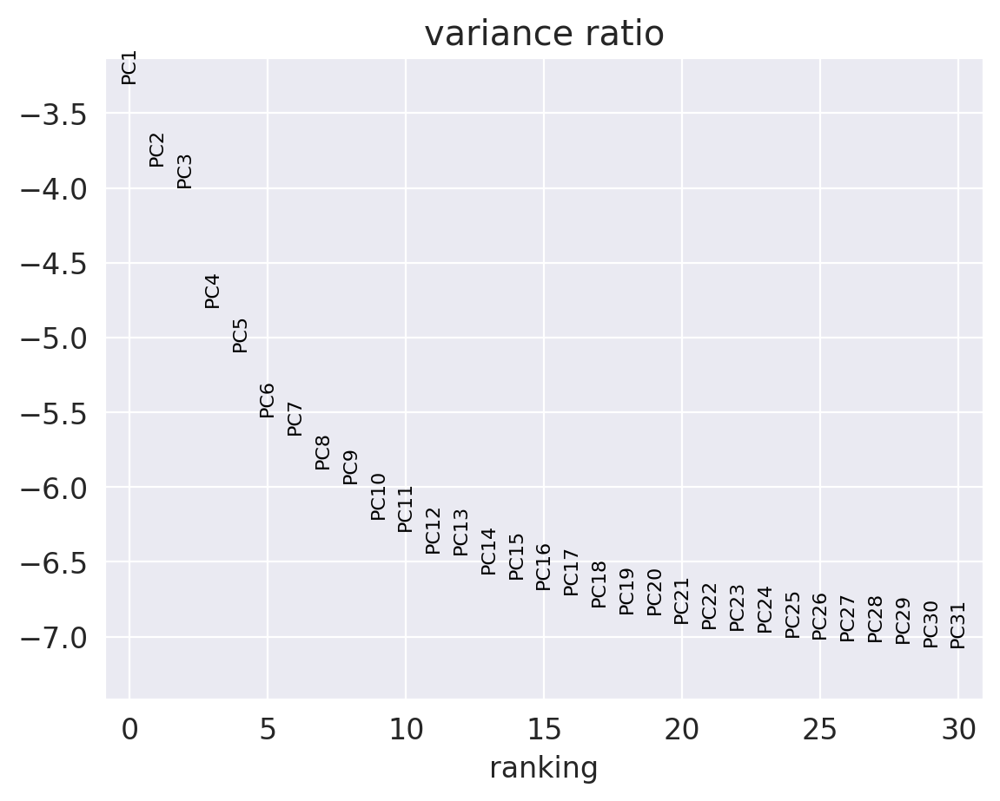

In [239]:
sc.pp.pca(adata_pl_2_raw,svd_solver='arpack')
sc.pl.pca_variance_ratio(adata_pl_2_raw, log=True)

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecate

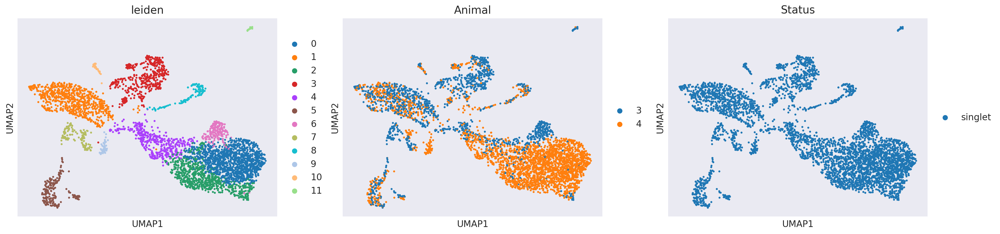

In [240]:
sc.pp.neighbors(adata_pl_2_raw, n_neighbors=30, n_pcs=30)
sc.tl.umap(adata_pl_2_raw)
sc.tl.leiden(adata_pl_2_raw, resolution=0.5)
sc.pl.umap(adata_pl_2_raw,color=['leiden','Animal','Status'])

In [241]:
adata_pl_2_raw.obs['Animal'].value_counts()

Animal
4    2793
3    1522
Name: count, dtype: int64

In [242]:
#Bath correction using harmony
sc.external.pp.harmony_integrate(adata_pl_2_raw, key='Animal', max_iter_harmony=100)

2023-11-09 17:01:32,076 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-11-09 17:01:35,112 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-11-09 17:01:35,134 - harmonypy - INFO - Iteration 1 of 100
2023-11-09 17:01:35,969 - harmonypy - INFO - Iteration 2 of 100
2023-11-09 17:01:36,772 - harmonypy - INFO - Iteration 3 of 100
2023-11-09 17:01:37,532 - harmonypy - INFO - Iteration 4 of 100
2023-11-09 17:01:38,379 - harmonypy - INFO - Iteration 5 of 100
2023-11-09 17:01:38,797 - harmonypy - INFO - Converged after 5 iterations


/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecate

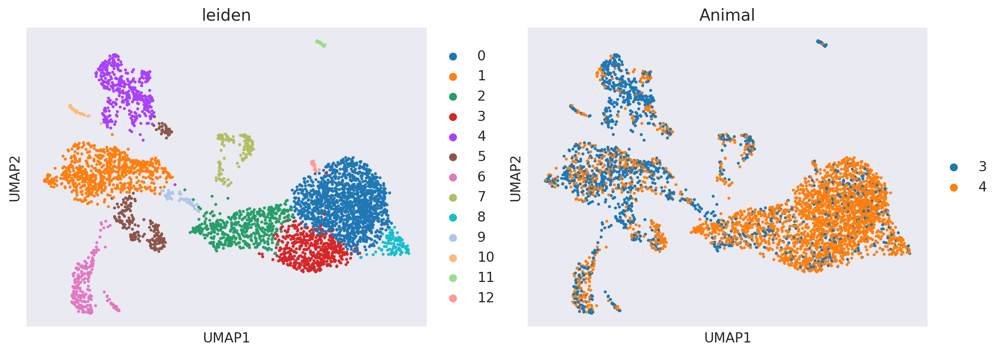

In [243]:
sc.pp.neighbors(adata_pl_2_raw, n_neighbors=30, n_pcs=30,use_rep='X_pca_harmony')
sc.tl.umap(adata_pl_2_raw)
sc.tl.leiden(adata_pl_2_raw, resolution=0.5)
sc.pl.umap(adata_pl_2_raw,color=['leiden','Animal'])

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_group

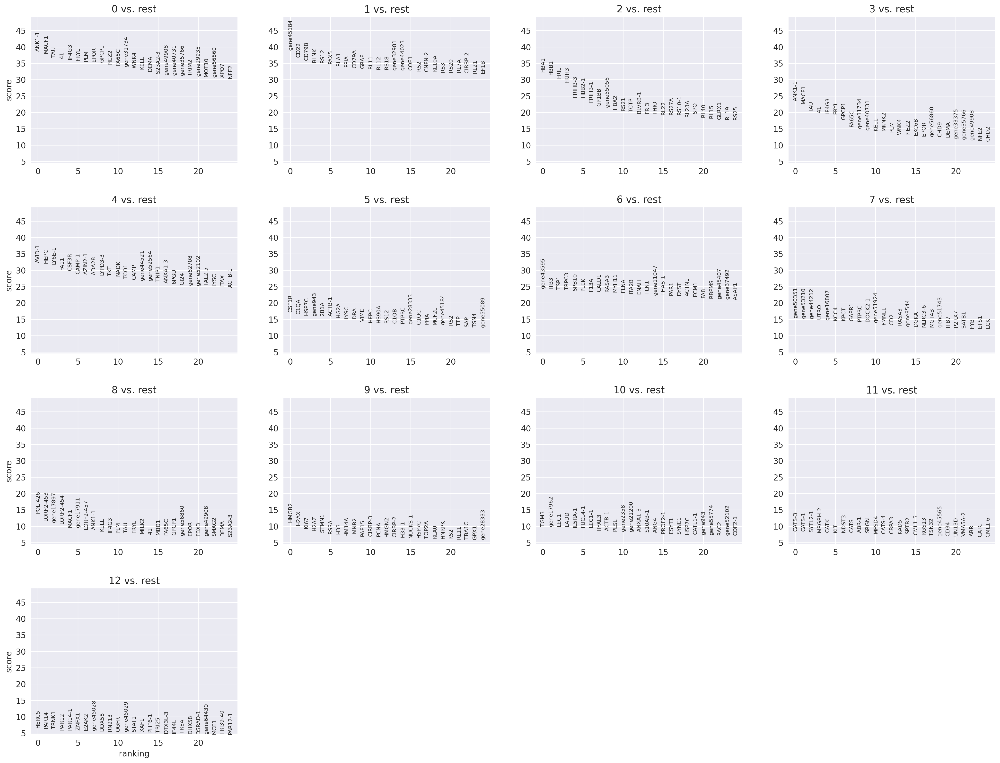

In [246]:
#Differrential expression
sc.tl.rank_genes_groups(adata_pl_2_raw, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata_pl_2_raw, n_genes=25, sharey=True)

In [244]:
adata_pl_2_raw.obs['dataset']='2'
adata_pl_1.obs['dataset']='1'

In [245]:
adata_pl_2_raw.var_names_make_unique()

In [248]:
adata_pl_1

AnnData object with n_obs × n_vars = 6929 × 31993
    obs: 'background_fraction', 'cell_probability', 'cell_size', 'droplet_efficiency', 'soup_assign', 'Animal', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'mt_score', 'hematopoetic_score', 'B_cells_score', 'prob_cells_score', 'macrophages_score', 'erythrocyte_progen_score', 'plasma_cells_score', 'neutrophil_score', 'cd4_tcell_score', 'cd8_tcell_score', 'dataset'
    var: 'ambient_expression', 'feature_type', 'genome', 'gene_id', 'cellbender_analyzed', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'Animal_colors', 'cell_size_lognormal_std', 'empty_droplet_size_lognormal_loc', 'empty_droplet_size_lognormal_scale', 'estimator', 'features_analyzed_inds', 'fraction_data_used_for_testing', 'learning_curve_learning_rate_epoch', 'learning_curve_learning_rate_value', 'learning_curve_test_elbo', 'learning_curve_test_epoch', 'l

In [249]:
adata_pl_2_raw

AnnData object with n_obs × n_vars = 4315 × 36804
    obs: 'background_fraction', 'cell_probability', 'cell_size', 'droplet_efficiency', 'Animal', 'Status', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'dataset'
    var: 'ambient_expression', 'feature_type', 'genome', 'gene_id', 'cellbender_analyzed', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'barcode_indices_for_latents', 'cell_size_lognormal_std', 'empty_droplet_size_lognormal_loc', 'empty_droplet_size_lognormal_scale', 'swapping_fraction_dist_params', 'barcodes_analyzed', 'barcodes_analyzed_inds', 'estimator', 'features_analyzed_inds', 'fraction_data_used_for_testing', 'learning_curve_learning_rate_epoch', 'learning_curve_learning_rate_value', 'learning_curve_test_elbo', 'learning_curve_test_epoch', 'learning_curve_train_elbo', 'learning_curve_train

In [250]:
var_names= adata_pl_1.var_names.intersection(adata_pl_2_raw.var_names)
adata_pl_1=adata_pl_1[:,var_names]
adata_pl_2_raw=adata_pl_2_raw[:,var_names]  

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [251]:
sc.tl.ingest(adata_pl_2_raw, adata_pl_1, obs='leiden')

/home/nikvaku/.local/lib/python3.9/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_ingest.py:511: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  values = [cat_array[inds].mode()[0] for inds in self._indices]


In [252]:
spleen_merged=adata_pl_1.concatenate(adata_pl_2_raw)

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/merge.py:217: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(dtype):
/home/nikvaku/.

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecate

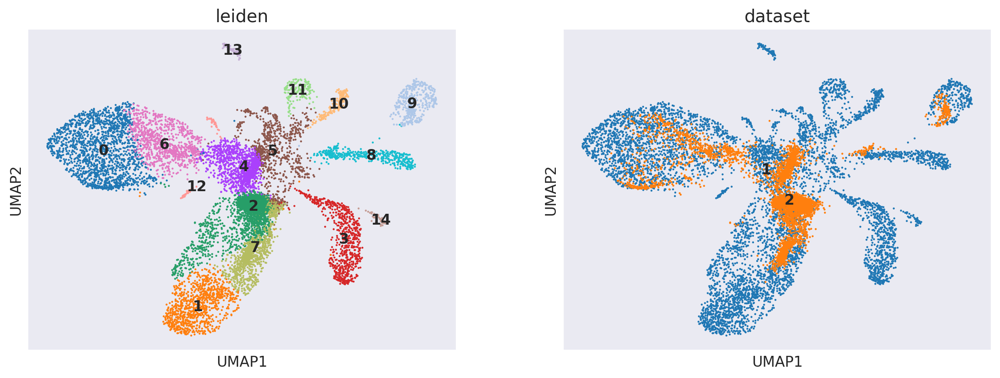

In [254]:
sc.pl.umap(spleen_merged,color=['leiden','dataset'],legend_loc='on data')

In [260]:
#Batch Correct with harmony
sc.external.pp.harmony_integrate(spleen_merged, key='Animal', max_iter_harmony=100)

2023-11-09 17:07:19,756 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-11-09 17:07:25,876 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-11-09 17:07:25,907 - harmonypy - INFO - Iteration 1 of 100
2023-11-09 17:07:28,267 - harmonypy - INFO - Iteration 2 of 100
2023-11-09 17:07:30,467 - harmonypy - INFO - Iteration 3 of 100
2023-11-09 17:07:32,668 - harmonypy - INFO - Iteration 4 of 100
2023-11-09 17:07:34,950 - harmonypy - INFO - Iteration 5 of 100
2023-11-09 17:07:37,228 - harmonypy - INFO - Iteration 6 of 100
2023-11-09 17:07:39,460 - harmonypy - INFO - Iteration 7 of 100
2023-11-09 17:07:41,966 - harmonypy - INFO - Iteration 8 of 100
2023-11-09 17:07:43,671 - harmonypy - INFO - Iteration 9 of 100
2023-11-09 17:07:45,767 - harmonypy - INFO - Iteration 10 of 100
2023-11-09 17:07:47,864 - harmonypy - INFO - Converged after 10 iterations


/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecate

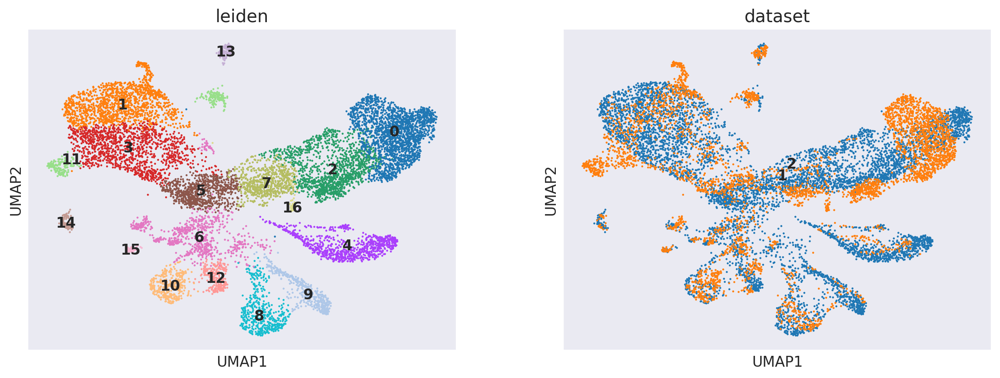

In [263]:
#Recompute the neighbors
sc.pp.neighbors(spleen_merged, n_neighbors=50, n_pcs=30,use_rep='X_pca_harmony')
sc.tl.umap(spleen_merged)
sc.tl.leiden(spleen_merged, resolution=0.5)
sc.pl.umap(spleen_merged,color=['leiden','dataset'],legend_loc='on data')

In [258]:
spleen_merged.obs['Animal'].value_counts()

Animal
4    2793
2    2581
1    2221
0    2127
3    1522
Name: count, dtype: int64

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecate

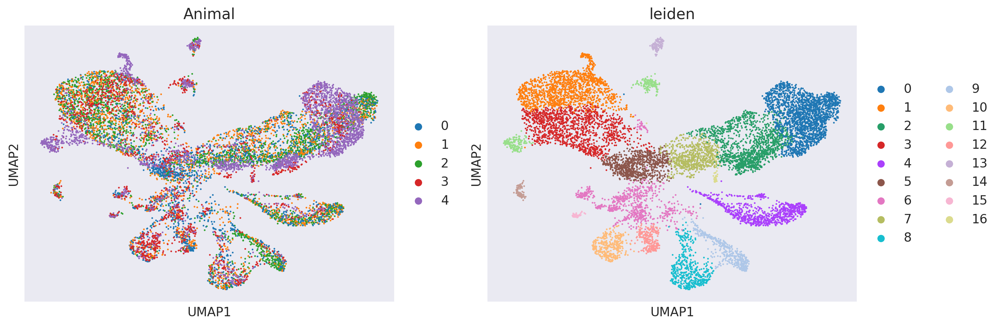

In [265]:
#Batch correct for animal
sc.pl.umap(spleen_merged,color=['Animal','leiden'])

In [348]:
leiden_mapper=dict(zip(spleen_merged.obs.index,spleen_merged.obs['leiden']))
animal_mapper_1=dict(zip(spleen_merged.obs.index,spleen_merged.obs['Animal']))

In [285]:
spleen_merged.obs

,background_fraction,cell_probability,cell_size,droplet_efficiency,soup_assign,Animal,n_genes,n_genes_by_counts,total_counts,total_counts_mt,...,prob_cells_score,macrophages_score,erythrocyte_progen_score,plasma_cells_score,neutrophil_score,cd4_tcell_score,cd8_tcell_score,dataset,Status,batch
barcode,,,,,,,,,,,,,,,,,,,,,
TTAGTCTTCTTCGGAA-1-0,0.027270,0.999955,123768.554688,0.728103,singlet,2,2442,2441,86677,446,...,-0.081234,-0.076982,1.433094,-0.105163,-0.323117,-0.296999,-0.190154,1,NaN,0
TCTCACGTCTCCTGAC-1-0,0.039414,0.999955,102173.992188,0.718848,singlet,2,1980,1976,69406,311,...,-0.051093,-0.063222,1.478350,-0.110675,-0.300390,-0.272463,-0.298300,1,NaN,0
TATTCCACAGCTTCGG-1-0,0.043228,0.999955,93975.234375,0.743674,singlet,2,2084,2081,65577,342,...,-0.079622,-0.123185,1.403247,-0.159376,-0.280233,-0.321724,-0.294015,1,NaN,0
CGATGGCAGAGCTGCA-1-0,0.035234,0.999955,72273.398438,0.787138,singlet,2,2370,2368,53255,269,...,-0.112533,-0.173876,1.311713,-0.217465,-0.345863,-0.348480,-0.345714,1,NaN,0
CGTGAATGTCAGTTTG-1-0,0.047951,0.999955,66664.289062,0.777454,singlet,1,1594,1593,47710,419,...,-0.030379,-0.087662,1.476675,-0.103064,-0.372082,-0.279651,-0.260469,1,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ATCGTAGGTCGCCTAG-1-1,0.369706,0.997383,2106.577881,0.505507,NaN,3,290,290,387,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,singlet,1
CTTCCTTAGCTCCACG-1-1,0.440456,0.658113,2047.423950,0.529784,NaN,4,251,251,343,5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,singlet,1
CTGCAGGTCGATACTG-1-1,0.275684,0.516893,2045.393311,0.506858,NaN,3,271,271,423,12,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,singlet,1


In [266]:
#Save the spleen merged
spleen_merged.write('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Inter_data/spleen_merged.h5ad')

In [372]:
adata_pl=anndata.read_h5ad('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/adata_pl_doublets_filtered_animal_labelled.h5ad')
adata_pl_2_raw= sc.read_10x_h5('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/matrix_filtered_clear/second_spleen/output_filtered.h5')
adata_pl_2_raw=anndata_from_h5('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/matrix_filtered_clear/second_spleen/output_filtered.h5')

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


Assuming we are loading a "filtered" file that contains only cells.


In [373]:
mapper=pd.read_table("/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/aPlwal.pri.V2.genome.annots.tsv")
mapper_dict = mapper.set_index('#gene_id')['EggNM.Preferred_name'].to_dict()
adata_pl_2_raw.var_names = [mapper_dict.get(x, x) if mapper_dict.get(x, x) != '.' else x for x in adata_pl_2_raw.var_names]

In [375]:
spleen_merged.var_names=[mapper_dict.get(x, x) if mapper_dict.get(x, x) != '.' else x for x in spleen_merged.var_names]

In [345]:
spleen_merged.obs['dataset'].value_counts()

dataset
1    6929
2    4315
Name: count, dtype: int64

In [346]:
spleen_merged.obs['Animal'].value_counts()

Animal
4    2793
2    2581
1    2221
0    2127
3    1522
Name: count, dtype: int64

In [350]:
leiden_mapper = {key[:-2]: value for key, value in leiden_mapper.items()}
animal_mapper_1 = {key[:-2]: value for key, value in animal_mapper_1.items()}

In [364]:
adata_pl.obs

,background_fraction,cell_probability,cell_size,droplet_efficiency,soup_assign,Animal,leiden,dataset
barcode,,,,,,,,
TTAGTCTTCTTCGGAA-1,0.027270,0.999955,123768.554688,0.728103,singlet,2,11,1
TCTCACGTCTCCTGAC-1,0.039414,0.999955,102173.992188,0.718848,singlet,2,11,1
TATTCCACAGCTTCGG-1,0.043228,0.999955,93975.234375,0.743674,singlet,2,11,1
CGATGGCAGAGCTGCA-1,0.035234,0.999955,72273.398438,0.787138,singlet,2,11,1
CGTGAATGTCAGTTTG-1,0.047951,0.999955,66664.289062,0.777454,singlet,1,11,1
...,...,...,...,...,...,...,...,...
TCTTAGTCACAGACGA-1,0.643340,0.624132,7963.850586,0.586558,singlet,1,2,1
GCCCAGATCGGAACTT-1,0.649425,0.981904,8735.075195,0.506109,singlet,1,14,1
TCGCTCATCTGCGGCA-1,0.471583,0.692119,8379.157227,0.539909,singlet,2,0,1


In [376]:
adata_pl.obs['leiden']='NA'
adata_pl.obs['Animal']='NA'

In [377]:
for i in adata_pl.obs.index:
    if i in leiden_mapper:
        adata_pl.obs.loc[i,'leiden']=leiden_mapper[i]
    if i in animal_mapper_1:
        adata_pl.obs.loc[i,'Animal']=animal_mapper_1[i]

In [378]:
adata_pl.obs['Animal'].value_counts()

Animal
NA    11851
2      2577
1      2221
0      2127
4        12
3         2
Name: count, dtype: int64

In [379]:
adata_pl_2_raw.obs

,background_fraction,cell_probability,cell_size,droplet_efficiency
barcode,,,,
GACCCAGGTAGACGTG-1,0.000897,0.999955,194654.750000,0.669043
CACAACAGTATGCTTG-1,0.001299,0.999955,225923.859375,0.541197
TCATACTAGAGCCTGA-1,0.001056,0.999955,184454.890625,0.624719
CAACAGTGTGGAGGTT-1,0.000952,0.999955,46296.457031,2.234821
AGTGCCGAGGGAGGCA-1,0.001579,0.999955,185242.890625,0.526207
...,...,...,...,...
CCTCATGAGAGTAACT-1,0.341288,0.994935,1722.159790,0.509318
GGGTCTGCATGGCTAT-1,0.596152,0.959761,1697.472778,0.521865
GTCATTTAGACATCAA-1,0.438423,0.893278,1701.922363,0.506145


In [380]:
adata_pl_2_raw.obs['leiden']='NA'
adata_pl_2_raw.obs['Animal']='NA'

In [381]:
for i in adata_pl_2_raw.obs.index:
    if i in leiden_mapper:
        adata_pl_2_raw.obs.loc[i,'leiden']=leiden_mapper[i]
    if i in animal_mapper_1:
        adata_pl_2_raw.obs.loc[i,'Animal']=animal_mapper_1[i]

In [382]:
adata_pl_2_raw.obs['Animal'].value_counts()

Animal
NA    7333
4     2793
3     1522
2        6
1        4
0        4
Name: count, dtype: int64

In [383]:
#Remove the cells labelled as 'NA'
adata_pl_2_raw = adata_pl_2_raw[adata_pl_2_raw.obs['Animal'] != 'NA']
adata_pl = adata_pl[adata_pl.obs['Animal'] != 'NA']

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [384]:
adata_pl_2_raw

View of AnnData object with n_obs × n_vars = 4329 × 65597
    obs: 'background_fraction', 'cell_probability', 'cell_size', 'droplet_efficiency', 'leiden', 'Animal'
    var: 'ambient_expression', 'feature_type', 'genome', 'gene_id', 'cellbender_analyzed'
    uns: 'barcode_indices_for_latents', 'cell_size_lognormal_std', 'empty_droplet_size_lognormal_loc', 'empty_droplet_size_lognormal_scale', 'swapping_fraction_dist_params', 'barcodes_analyzed', 'barcodes_analyzed_inds', 'estimator', 'features_analyzed_inds', 'fraction_data_used_for_testing', 'learning_curve_learning_rate_epoch', 'learning_curve_learning_rate_value', 'learning_curve_test_elbo', 'learning_curve_test_epoch', 'learning_curve_train_elbo', 'learning_curve_train_epoch', 'target_false_positive_rate'
    obsm: 'gene_expression_encoding'

In [385]:
adata_pl

View of AnnData object with n_obs × n_vars = 6939 × 65597
    obs: 'background_fraction', 'cell_probability', 'cell_size', 'droplet_efficiency', 'soup_assign', 'Animal', 'leiden'
    var: 'ambient_expression', 'feature_type', 'genome', 'gene_id', 'cellbender_analyzed'
    uns: 'cell_size_lognormal_std', 'empty_droplet_size_lognormal_loc', 'empty_droplet_size_lognormal_scale', 'estimator', 'features_analyzed_inds', 'fraction_data_used_for_testing', 'learning_curve_learning_rate_epoch', 'learning_curve_learning_rate_value', 'learning_curve_test_elbo', 'learning_curve_test_epoch', 'learning_curve_train_elbo', 'learning_curve_train_epoch', 'swapping_fraction_dist_params', 'target_false_positive_rate'
    obsm: 'gene_expression_encoding'

In [386]:
#Merge the two datasets
adata_pl_2_raw.obs['dataset']='2'
adata_pl.obs['dataset']='1'


/tmp/ipykernel_1152512/2408330852.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_pl_2_raw.obs['dataset']='2'
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/tmp/ipykernel_1152512/2408330852.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_pl.obs['dataset']='1'
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [387]:
adata_pl_2_raw.var_names_make_unique()
adata_pl.var_names_make_unique()

In [388]:
var_names= adata_pl.var_names.intersection(adata_pl_2_raw.var_names)
adata_pl=adata_pl[:,var_names]
adata_pl_2_raw=adata_pl_2_raw[:,var_names]


/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


ValueError: `A` must be of floating or complex floating data type.

ValueError: There is no neighbors data in `adata.uns["neighbors"]`.
Please run pp.neighbors.

In [391]:
spleen_merged_raw=adata_pl.concatenate(adata_pl_2_raw)

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/merge.py:217: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(dtype):
/home/nikvaku/.

In [392]:
#Save the spleen merged_raw
spleen_merged_raw.write('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Inter_data/spleen_merged_raw.h5ad')

Index(['POL3', 'gene26597', 'gene26598', 'SPX2', 'gene26599', 'gene26600',
       'gene26601', 'gene26602', 'PKNOX2', 'POL',
       ...
       'gene65588', 'gene65589', 'gene65590', 'gene65591', 'gene65592',
       'NU5M-1', 'COX1-1', 'COX1-2', 'NU2M', 'gene65597'],
      dtype='object', length=65597)

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_group

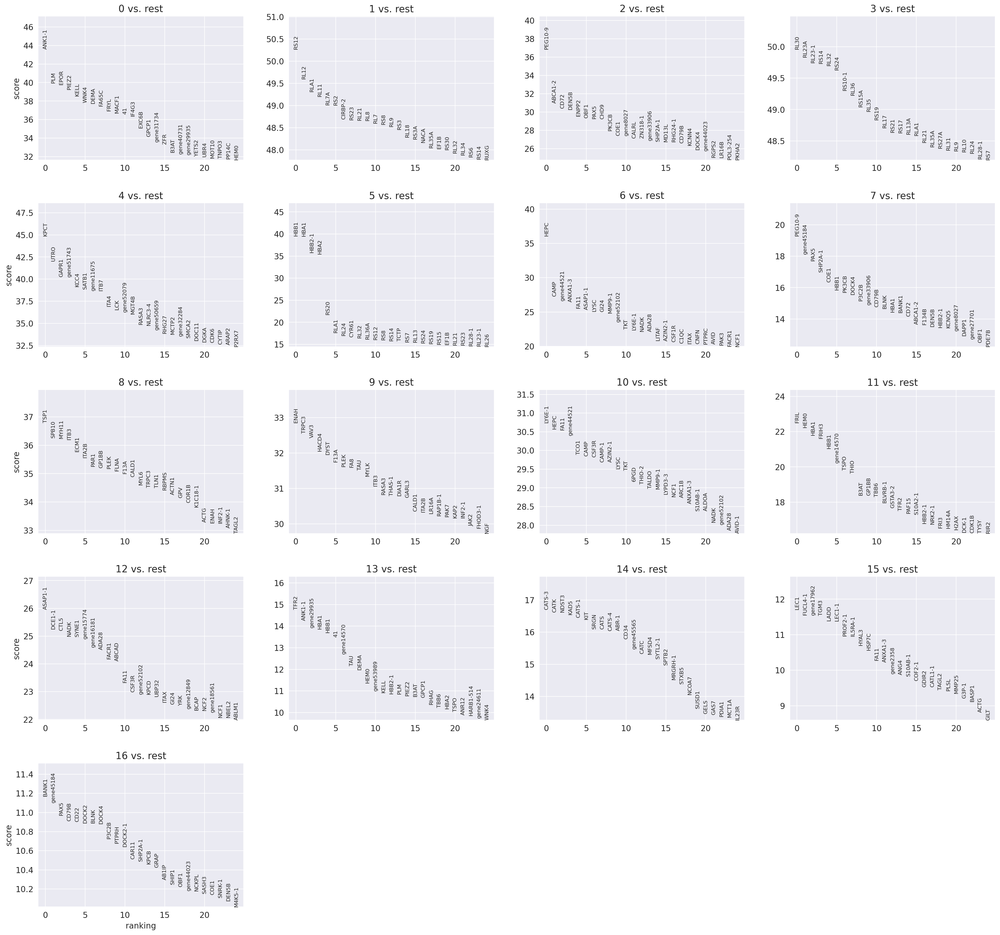

In [397]:
#Differentialy expressed genes
sc.tl.rank_genes_groups(spleen_merged, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(spleen_merged, n_genes=25, sharey=False)

In [488]:
for i in spleen_merged.var_names:
    if i.startswith('IL12'):
        print(i)

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) ins

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) ins

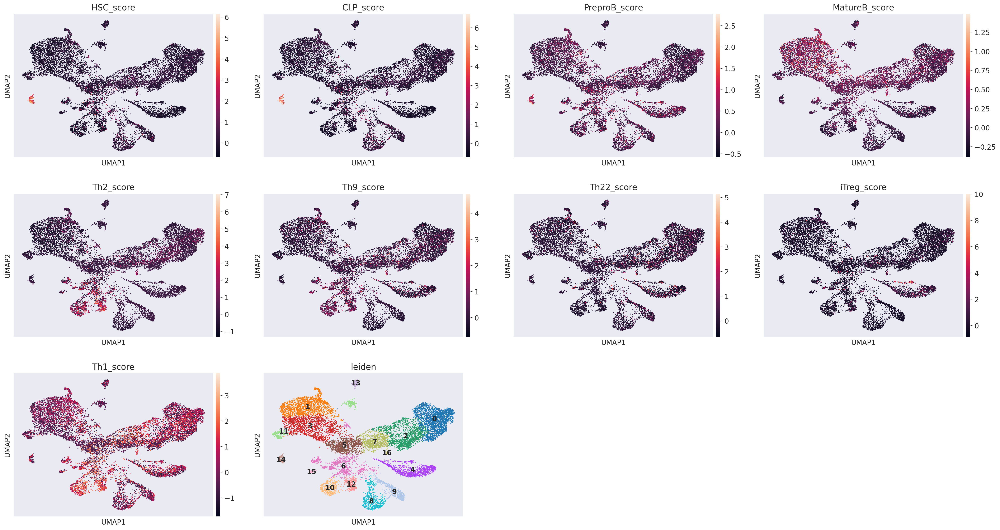

In [486]:
|#HSC markers
HSC=["CD34","KIT","IL7","FLT3"]
CLP=["CD34","KIT","CXCR5"]
PreproB=["CD34","IL7","TDT","CXCR5","RUNX2","RAG1","PTPRC","IRF8"]
MatureB = ["CD20B","CD79A","4EBP1","PAX5","PAX5-1","VPREB","VPREB-1","VPREB-2","VPREB-3","VPREB-4","VPREB-5","VPREB-6","VPREB-7","VPREB-8","IGHM-1","IGHM"]
#T cells
Th2=["IL4RA" , "IL5RA"]
Th9=["IL21R" , "IRF4", "IRF4-1","SPI1"]
Th22 =["AHR", "AHR-1" , "IL21R"]
iTreg =["IL2RA","IL2RB", "IL2RG"]
Th1 =["STAT1" , "IL12RB2"]
sc.tl.score_genes(spleen_merged, HSC, score_name='HSC_score')
sc.tl.score_genes(spleen_merged, CLP, score_name='CLP_score')
sc.tl.score_genes(spleen_merged, PreproB, score_name='PreproB_score')
sc.tl.score_genes(spleen_merged, MatureB, score_name='MatureB_score')
sc.tl.score_genes(spleen_merged, Th2, score_name='Th2_score')
sc.tl.score_genes(spleen_merged, Th9, score_name='Th9_score')
sc.tl.score_genes(spleen_merged, Th22, score_name='Th22_score')
sc.tl.score_genes(spleen_merged, iTreg, score_name='iTreg_score')
sc.tl.score_genes(spleen_merged, Th1, score_name='Th1_score')
sc.pl.umap(spleen_merged, color=['HSC_score','CLP_score','PreproB_score','MatureB_score','Th2_score','Th9_score','Th22_score','iTreg_score','Th1_score',"leiden"],legend_loc='on data')

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


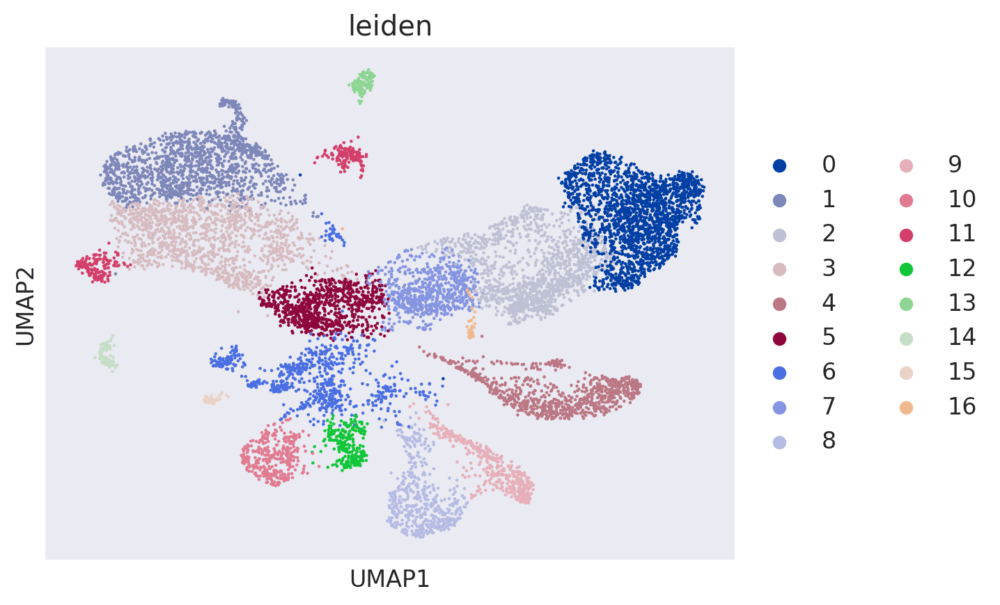

In [491]:
sc.tl.leiden(spleen_merged, resolution=0.5)
sc.pl.umap(spleen_merged,color='leiden')

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


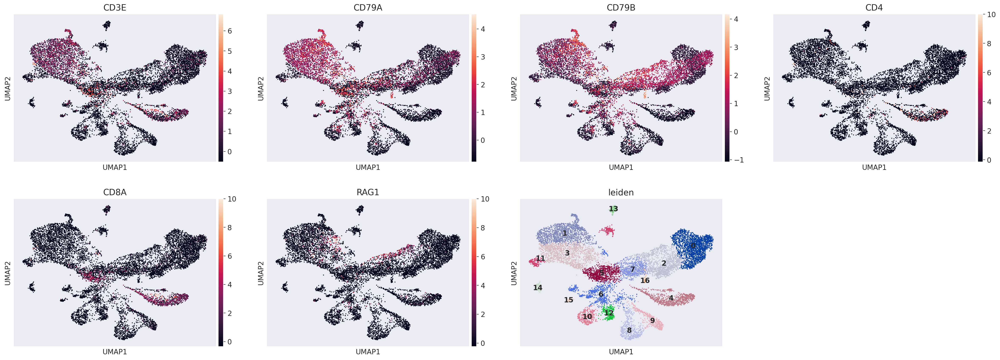

In [530]:
sc.pl.umap(spleen_merged,color=['CD3E','CD79A','CD79B','CD4','CD8A','RAG1','leiden'],legend_loc='on data')

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecate

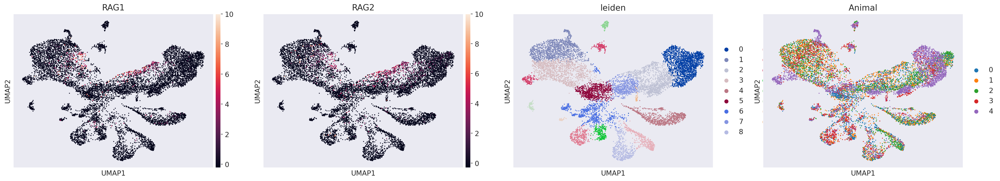

In [504]:
sc.pl.umap(spleen_merged,color=['RAG1','RAG2','leiden','Animal'])

In [525]:
for i in spleen_merged.var_names:
    if i.startswith('CLG'):
        print(i)

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


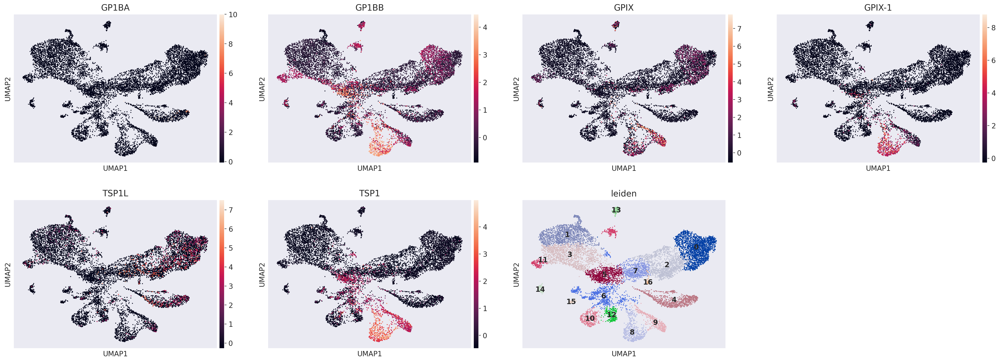

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprec

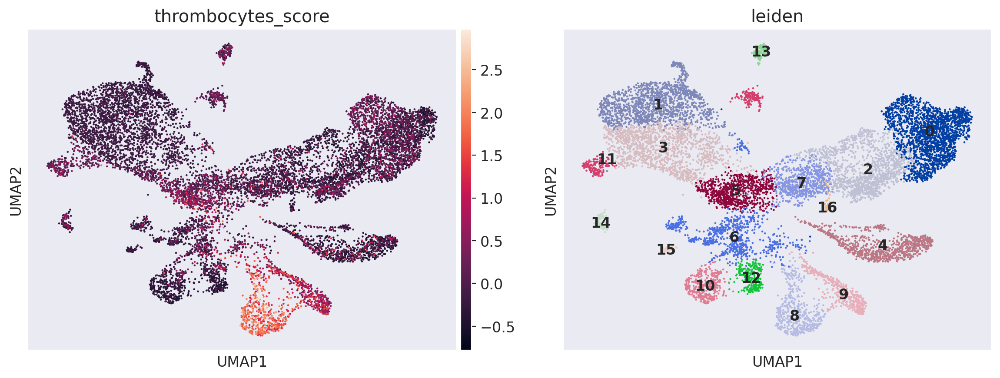

In [513]:
#Thrombocytes
sc.pl.umap(spleen_merged,color=['GP1BA','GP1BB','GPIX','GPIX-1','TSP1L','TSP1','leiden'],legend_loc='on data')
thrombocytes=["GP1BA","GP1BB","GPIX","GPIX-1","TSP1L","TSP1"]
sc.tl.score_genes(spleen_merged, thrombocytes, score_name='thrombocytes_score')
sc.pl.umap(spleen_merged,color=['thrombocytes_score','leiden'],legend_loc='on data')

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_group

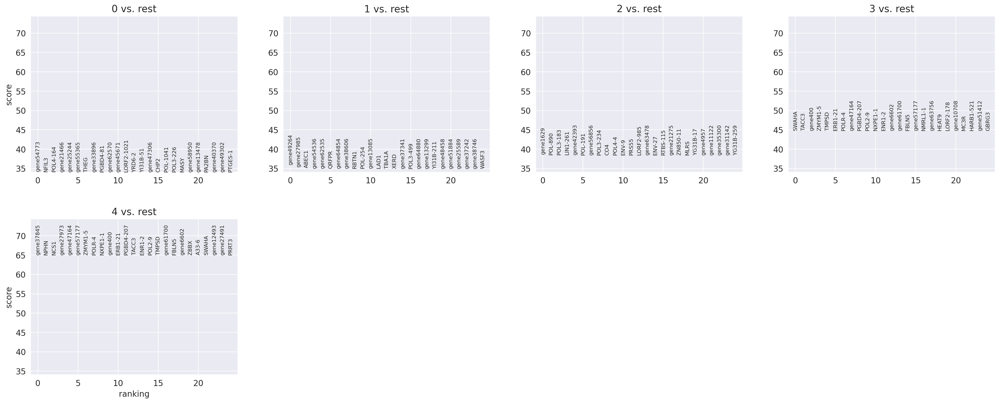

In [529]:
#DEG
sc.tl.rank_genes_groups(spleen_merged, 'Animal', method='wilcoxon')
sc.pl.rank_genes_groups(spleen_merged, n_genes=25, sharey=True)

In [523]:
#T_cells
sc.pl.umap(spleen_merged_raw,color=["TRAC","GZMB"])

KeyError: "Could not find 'umap' or 'X_umap' in .obsm"